**Instalation de Basemap**

In [0]:
%%bash
apt-get install libgeos-3* libgeos-dev
pip install https://github.com/matplotlib/basemap/archive/master.zip

**Import libraries:**

- matplotlib (2D plotting)
- pylab (scientific computing)
- basemap (plotting 2D data on maps)
- scikit-learn (machine learning)
- pandas (data structures and data analysis tools)

In [0]:
%matplotlib inline
%pylab inline
from mpl_toolkits.basemap import Basemap
import sklearn
import pandas as pd
from scipy.stats.mstats import zscore
from sklearn import linear_model
import warnings
import xarray as xr
import scipy.signal
warnings.filterwarnings("ignore") # disable warnings
pylab.rcParams['figure.figsize']=(20,20) # graph size

**Plot functions**


In [0]:
# function to plot images  
def plot_im(lon,lat,im,size_points,var_name):
    
    # transform to arrays (just in case)
    lon=array(lon)
    lat=array(lat)
    im=array(im)
    
    if max(lon)-min(lon)<100:
      # Mercator projection (for small zone)
      m=Basemap(projection='merc',llcrnrlat=nanmin(lat),urcrnrlat=nanmax(lat),\
                llcrnrlon=nanmin(lon),urcrnrlon=nanmax(lon),lat_0=(nanmax(lat)+nanmin(lat))*0.5,\
                lon_0=(nanmax(lon)+nanmin(lon))*0.5,resolution='l')
    else:
      # Orthogonal projection (for large zone)
      m=Basemap(projection='ortho',lat_0=0,lon_0=0,resolution='l')
    # you can use other projections (see https://matplotlib.org/basemap/users/mapsetup.html)
    
    # transform (lon,lat) to (x,y)
    x,y=m(lon,lat)

    # plot
    im=ma.masked_where(isnan(im),im)
    res=m.scatter(x,y,size_points,im,'o',alpha=1,cmap='jet',lw=0)
    m.drawcoastlines()
    m.fillcontinents()
    parallels = linspace(nanmin(lat),nanmax(lat),15)
    meridians = linspace(nanmin(lon),nanmax(lon),15)
    #m.drawparallels(parallels,labels=[1,0,0,1],fontsize=10)
    #m.drawmeridians(meridians,labels=[1,0,0,1],fontsize=10)
    cb=m.colorbar(res,location="right")
    cb.set_label(var_name,fontsize=15)
    
# function to plot time series
def plot_ts(time,ts,line_type,var_name):

    # plot
    plot_date(time,ts,line_type)
    xlabel('Time',fontsize=15)
    ylabel(var_name,fontsize=15)

#**GCP** 
##Here, we just select our specific aera of study in the dataset. We extract then only the corresponding data into our Drive to prevent many querry requests.

In [0]:
"""
from google.colab import auth
auth.authenticate_user()

%%bigquery --project alert-ground-261008 output
SELECT time,lon,lat,sst,ssh
FROM bdo2020.bdo2020.1998_2015
WHERE lon>100 AND lon<160 AND lat>20 AND lat<45

output.to_csv('/content/drive/My Drive/Colab Notebooks/data_typhoons')
"""

#**Data import from Drive**

In [0]:
from google.colab import drive
drive.mount('/content/drive')
data = pd.read_csv('/content/drive/My Drive/Colab Notebooks/data_typhoons',names = ['time','lon','lat','sst','ssh'],skiprows=1,dtype= float)

In [0]:
lat = data.lat.values
lon = data.lon.values
t = data.time.values
sst = data.sst.values
data_jap=data[(data.lon>100) & (data.lon<160) & (data.lat>20) & (data.lat<38)]

#**Zone d'étude**

- 100 < longitude < 160
- 20 < latitude < 38



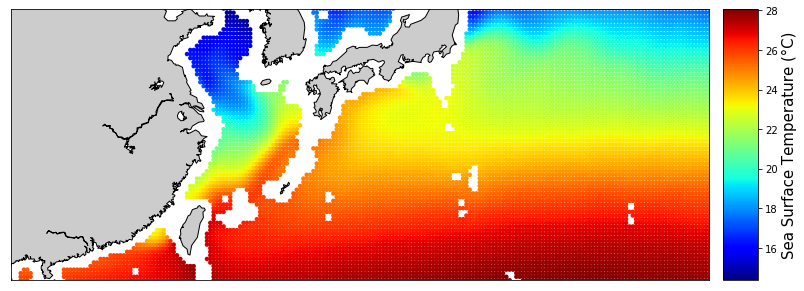

In [0]:
sst_im=data_jap.groupby(['lon','lat'])['sst'].mean()
lon_im=data_jap.groupby(['lon','lat'])['lon'].mean()
lat_im=data_jap.groupby(['lon','lat'])['lat'].mean()
figure(figsize=(28,5))
plot_im(lon_im,lat_im,sst_im,20,'Sea Surface Temperature (°C)')

#**Data Visualisation** 
##Now we look at the mean SST and its standard deviation over the all domain for each time step.


In [0]:
t = data_jap.groupby(['time'])['time'].mean().values
sst_mean = data_jap.groupby(['time'])['sst'].mean().values
sst_std = data_jap.groupby(['time'])['sst'].std().values

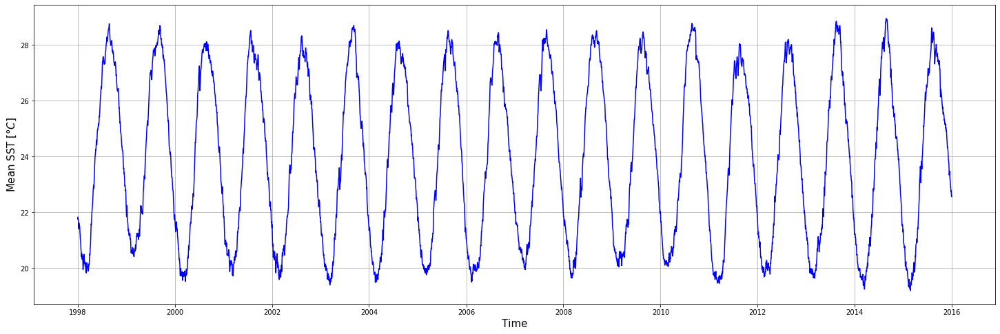

In [0]:
figure(figsize=(25,8))
plot_ts(t,sst_mean,'b','Mean SST [$°C$]')
grid();

#**First Analysis** 
##In order to detect Typhoons, we first look at in the mean (& std) SST time serie if there are sharp changes in temperature. Which could be related to the presence of thyphoon.

In [0]:
# Our function that compute the difference. One can choose the time step with n.
def diff(ar,n):
  return np.array(ar[n:]) - np.array(ar[:-n])

##We assume that daily meteorological events can biased our analysis. Then, we choose to only look at changes every 5 days, which is the half time scale of typhoons.

In [0]:
d = 5 #nbr of days

diff_sst_mean = diff(sst_mean,d)

diff_sst_std = diff(sst_std,d)

tdiff = t[:-d] # new time array

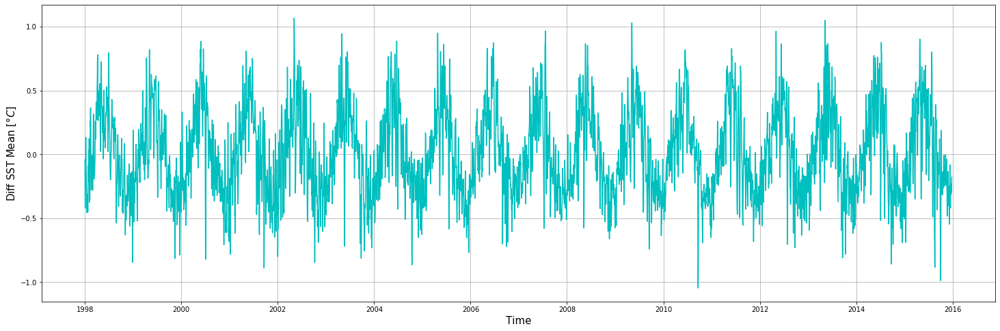

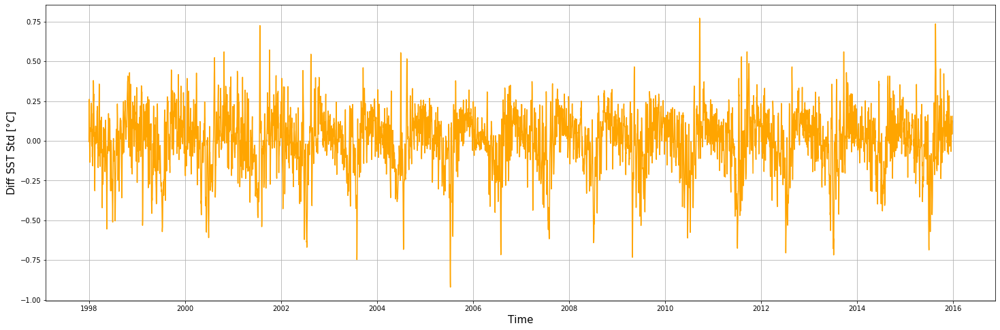

In [0]:
figure(figsize=(25,8))
plot_ts(tdiff,diff_sst_mean,'c-','Diff SST Mean [$°C$]')
grid()
figure(figsize=(25,8))
plot_ts(tdiff,diff_sst_std,'orange','Diff SST Std [$°C$]')
grid()

##We can observe annual oscillations. We now fit a model in order to remove seasonal effect. 

In [0]:
from sklearn.linear_model import LinearRegression

x1 = tdiff
x2 = np.sin(2*np.pi/365.25*x1) #yearly
x3 = np.cos(2*np.pi/365.25*x1)

X_mean = np.vstack((x1,x2,x3)).T
X_std = np.vstack((x1,x2,x3)).T

model = linear_model.LinearRegression()
model.fit(X_mean,diff_sst_mean)
y_mean = model.predict(X_mean)

model.fit(X_std, diff_sst_std)
y_std = model.predict(X_std)


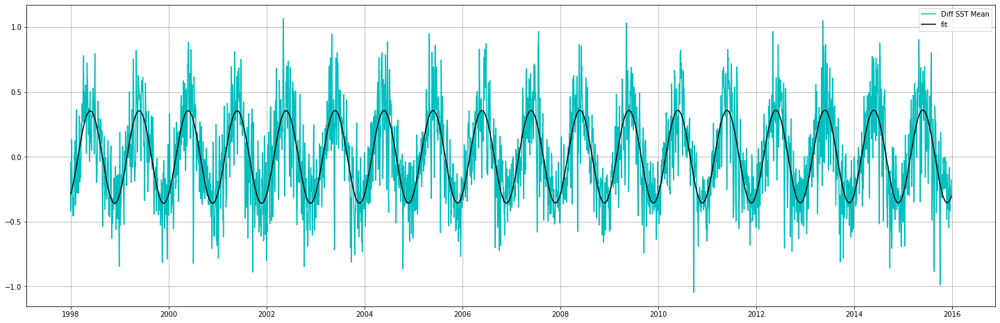

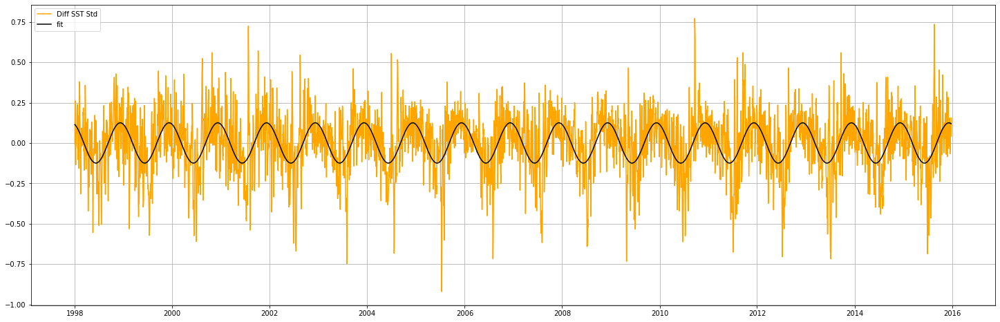

In [0]:
figure(figsize=(25,8))
plot_date(tdiff,diff_sst_mean, 'c-',label = 'Diff SST Mean')
plot_date(tdiff,y_mean,'k-',label='fit')
legend()
grid()
figure(figsize=(25,8))
plot_date(tdiff,diff_sst_std, 'orange',label = 'Diff SST Std')
plot_date(tdiff,y_std,'k-',label='fit')
grid()
legend();

##After having substracted the annual oscillation, we look at absolute differences in the mean and standard deviation of SST. In order to compare both time series we normalized them.

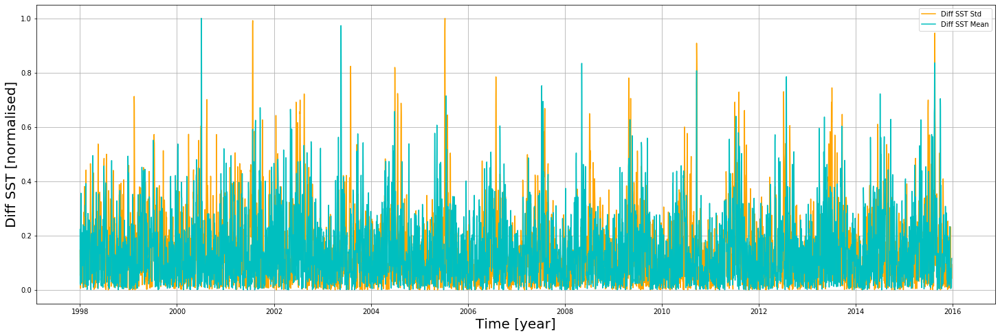

In [0]:
res_m = abs(diff_sst_mean-y_mean)
res_s = abs(diff_sst_std-y_std)
figure(figsize=(25,8))
plot_date(tdiff,res_s/res_s.max(),'orange',label = 'Diff SST Std')
plot_date(tdiff,res_m/res_m.max(),'c',label = 'Diff SST Mean')
xlabel('Time [year]',fontsize=20)
ylabel('Diff SST [normalised]',fontsize=20)
legend()
grid()

##We assume that peaks in the mean (or std) SST difference trace the presence of typhoons. So, we select only the maximal value of each peak (that represents one specific day) if this one is larger than a fixed threshold.  

In [0]:
res_m_norm = res_m/res_m.max()
res_s_norm = res_s/res_s.max()

thr = 0.45 # arbitrary threshold

idx_m = []
idx_s = []

for i in range(1,res_m.shape[0]-1):
  if (res_m_norm[i] > res_m_norm[i-1]) & (res_m_norm[i] > res_m_norm[i+1]):
    if res_m_norm[i] > thr:
      idx_m.append(i)
  if (res_s_norm[i] > res_s_norm[i-1]) & (res_s_norm[i] > res_s_norm[i+1]):
    if res_s_norm[i] > thr:
      idx_s.append(i)

idx_m = np.array(idx_m)
idx_s = np.array(idx_s)

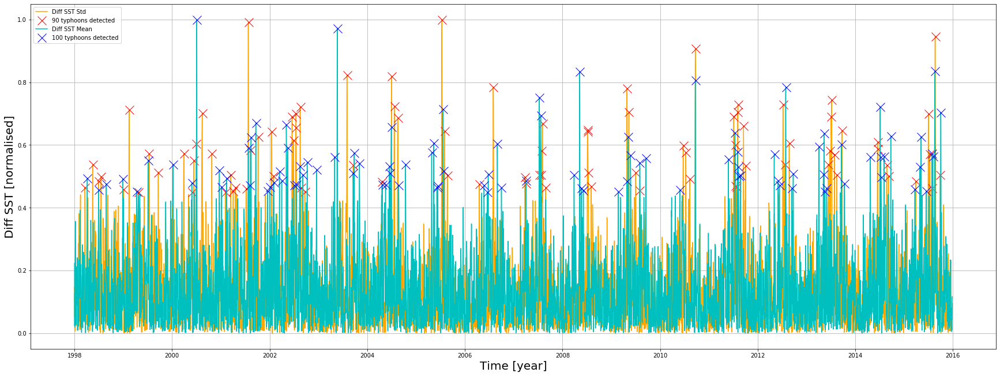

In [0]:
figure(figsize=(30,11))

plot_date(tdiff,res_s_norm,'orange',label = 'Diff SST Std')
plot_date(tdiff[idx_s],res_s_norm[idx_s],'rx',markersize = 15,label=str(idx_s.shape[0])+' typhoons detected')

plot_date(tdiff,res_m_norm,'c',label = 'Diff SST Mean')
plot_date(tdiff[idx_m],res_m_norm[idx_m],'bx',markersize = 15,label=str(idx_m.shape[0])+' typhoons detected')

xlabel('Time [year]',fontsize=20)
ylabel('Diff SST [normalised]',fontsize=20)
grid()
legend();

##We get 90 and 100 typhoons detected with respectively the standard deviation and the mean SST difference.

#**Results :**
## **1) Statistics**

In [0]:
pos_time_m = tdiff[idx_m]
df_typhoon_m = pd.DataFrame(data=list(pos_time_m),columns=['time'])
df_typhoon_m['day'] = df_typhoon_m.time.apply(lambda x:datetime.date.fromordinal(int(x)).day)
df_typhoon_m['month'] = df_typhoon_m.time.apply(lambda x:datetime.date.fromordinal(int(x)).month)
df_typhoon_m['year'] = df_typhoon_m.time.apply(lambda x:datetime.date.fromordinal(int(x)).year)

pos_time_s = tdiff[idx_s]
df_typhoon_s = pd.DataFrame(data=list(pos_time_s),columns=['time'])
df_typhoon_s['day'] = df_typhoon_s.time.apply(lambda x:datetime.date.fromordinal(int(x)).day)
df_typhoon_s['month'] = df_typhoon_s.time.apply(lambda x:datetime.date.fromordinal(int(x)).month)
df_typhoon_s['year'] = df_typhoon_s.time.apply(lambda x:datetime.date.fromordinal(int(x)).year)

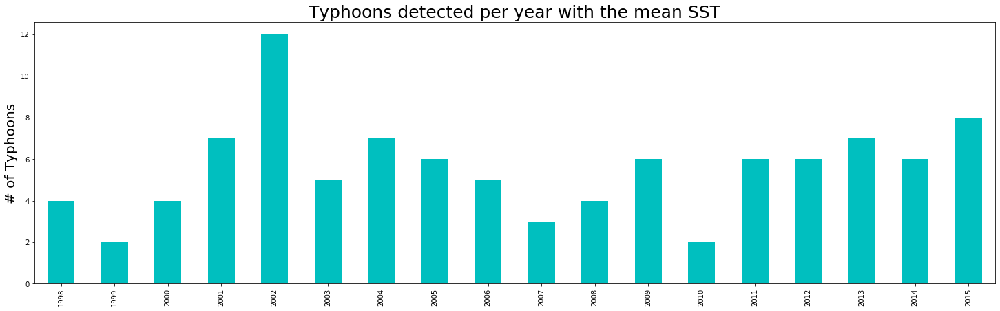

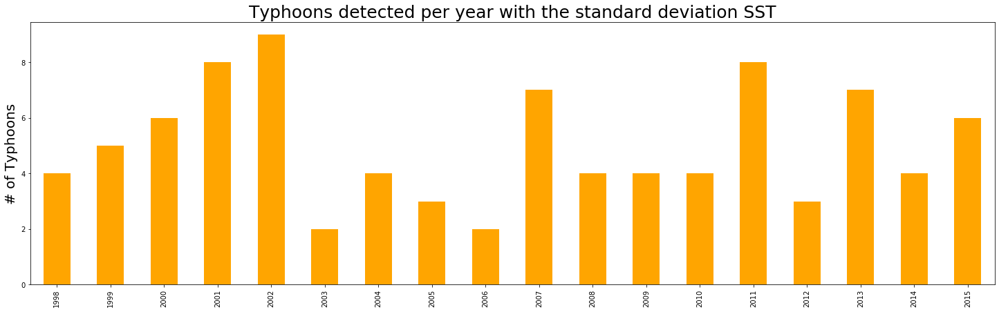

In [0]:
plt.figure(figsize=(25,7))
df_typhoon_m.year.value_counts(sort=False).plot(colors='c',kind='bar')
ylabel('# of Typhoons',fontsize=20)
title('Typhoons detected per year with the mean SST',fontsize=25)
plt.figure(figsize=(25,7))
df_typhoon_s.year.value_counts(sort=False).plot(colors='orange',kind='bar')
ylabel('# of Typhoons',fontsize=20)
title('Typhoons detected per year with the standard deviation SST',fontsize=25);

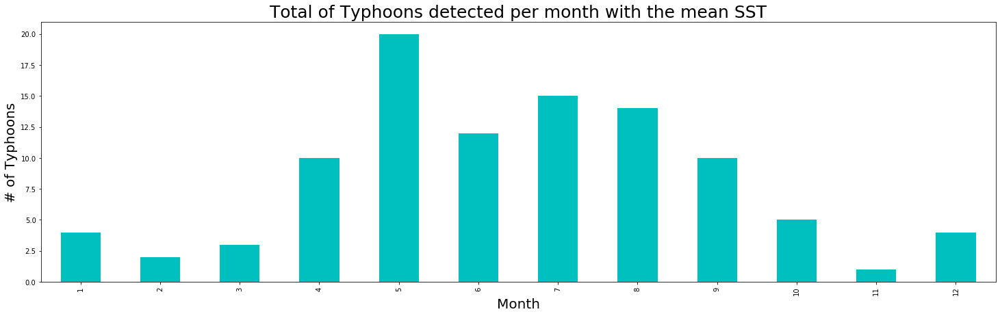

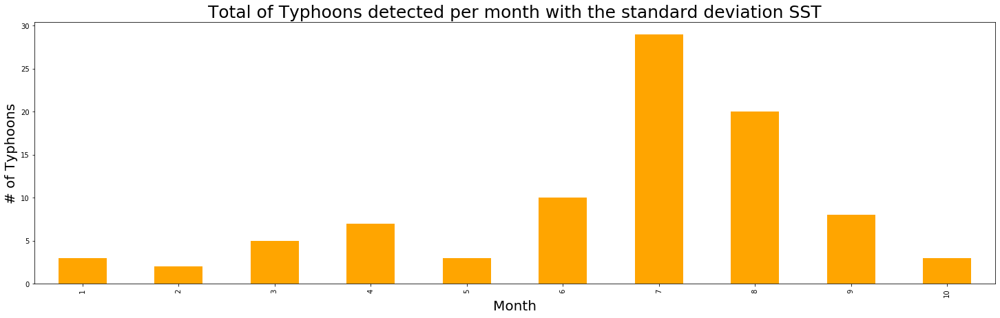

In [0]:
plt.figure(figsize=(25,7))
df_typhoon_m.month.value_counts(sort=False).plot(colors='c',kind='bar')
xlabel('Month',fontsize=20)
ylabel('# of Typhoons',fontsize=20)
title('Total of Typhoons detected per month with the mean SST',fontsize=25)
plt.figure(figsize=(25,7))
df_typhoon_s.month.value_counts(sort=False).plot(colors='orange',kind='bar')
xlabel('Month',fontsize=20)
ylabel('# of Typhoons',fontsize=20)
title('Total of Typhoons detected per month with the standard deviation SST',fontsize=25);

##Now we want to correlate the two set of typhoons in order to end up with detections that relate on 2 criterions instead of one (i.e. the difference of mean and std SST).

---
**Our method :** \\
For each typhoons detected we compute the mean between its normalised temperature difference and its value at the equivalent index in the other time serie. If the mean is larger than an arbitrary threshold then we keep the typhoon. We applied this on the two time series (mean & std).

In [0]:
# Our function:

def corr(ar1,ar2,id1,id2,thr=0.25):

  idx_corr = []
  ar_t1 = np.append(ar1[id1],ar2[id1])
  ar_t1 = np.reshape(ar_t1, (2,ar1[id1].shape[0]))
  mean_ar_t1 = np.mean(ar_t1,axis=0)
  std_ar1 = np.std(ar1[id1])

  ar_t2 = np.append(ar1[id2],ar2[id2])
  ar_t2 = np.reshape(ar_t2, (2,ar1[id2].shape[0]))
  mean_ar_t2 = np.mean(ar_t2,axis=0)
  std_ar2 = np.std(ar2[id2])

  for i in range(ar1[id1].shape[0]):
    if mean_ar_t1[i] + std_ar1 >= thr:
      idx_corr.append(id1[i])
  for i in range(ar1[id2].shape[0]):
    if mean_ar_t2[i] + std_ar2 >= thr:
      idx_corr.append(id2[i])
  
  return np.sort(idx_corr)

In [0]:
idx_c = corr(res_m_norm,res_s_norm,idx_m,idx_s,0.4) 

##We get now a total of 170 typhoons detected with our method.




In [0]:
pos_time_c = tdiff[idx_c]
df_typhoon_c = pd.DataFrame(data=list(pos_time_c),columns=['time'])
df_typhoon_c['day'] = df_typhoon_c.time.apply(lambda x:datetime.date.fromordinal(int(x)).day)
df_typhoon_c['month'] = df_typhoon_c.time.apply(lambda x:datetime.date.fromordinal(int(x)).month)
df_typhoon_c['year'] = df_typhoon_c.time.apply(lambda x:datetime.date.fromordinal(int(x)).year)

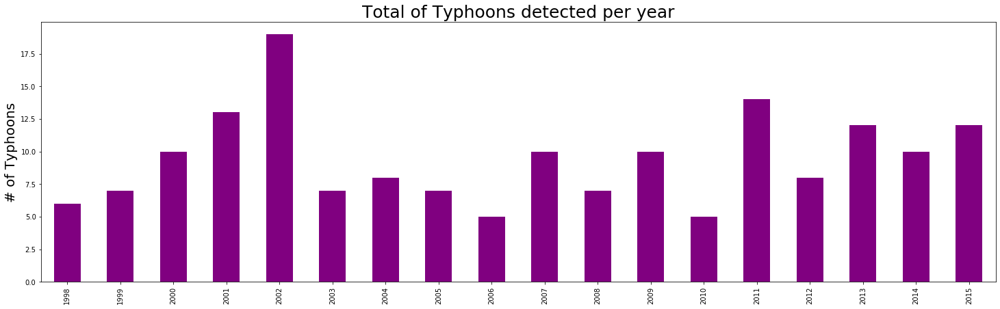

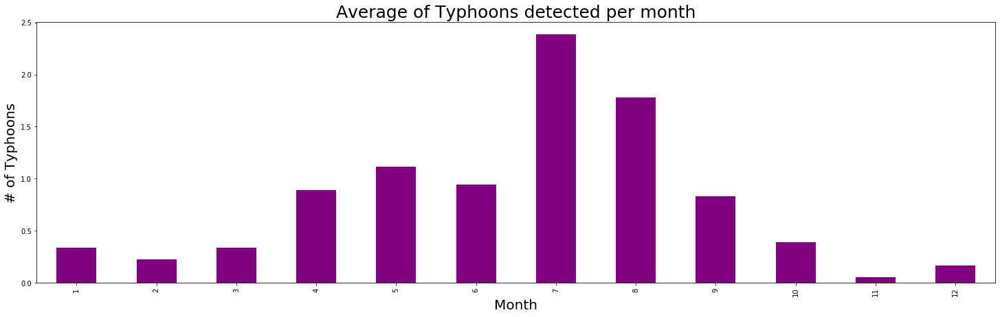

In [0]:
plt.figure(figsize=(25,7))
df_typhoon_c.year.value_counts(sort=False).plot(colors='purple',kind='bar')
ylabel('# of Typhoons',fontsize=20)
title('Total of Typhoons detected per year',fontsize=25)
plt.figure(figsize=(25,7))
(df_typhoon_c.month.value_counts(sort=False)/18).plot(colors='purple',kind='bar')
ylabel('# of Typhoons',fontsize=20)
xlabel('Month',fontsize=20)
title('Average of Typhoons detected per month',fontsize=25);

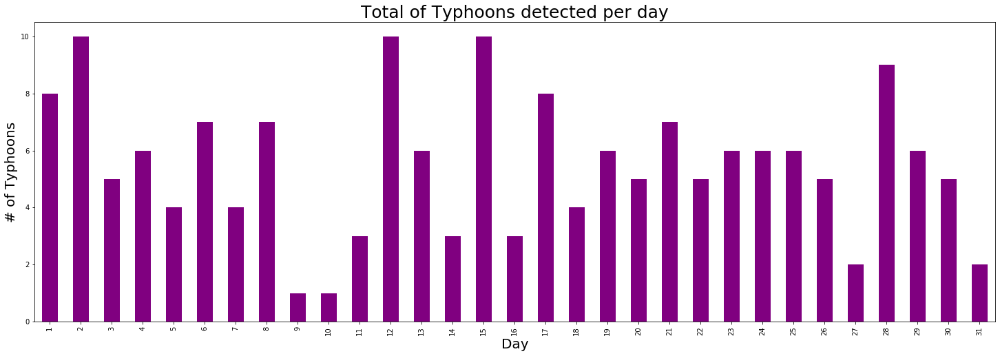

In [0]:
plt.figure(figsize=(25,8))
df_typhoon_c.day.value_counts(sort=False).plot(colors='purple',kind='bar')
ylabel('# of Typhoons',fontsize=20)
xlabel('Day',fontsize=20)
title('Total of Typhoons detected per day',fontsize=25);

In [0]:
most_intense_typhoon = time_typhoon[argmax(res_m_norm[idx_c])]

730304.0

## **2) Typhoons Visualisation**

In [0]:
sst_plot = data_jap.groupby(['time','lon','lat'])['sst'].mean()
t_jap = data_jap.groupby(['time','lon','lat'])['time'].mean()


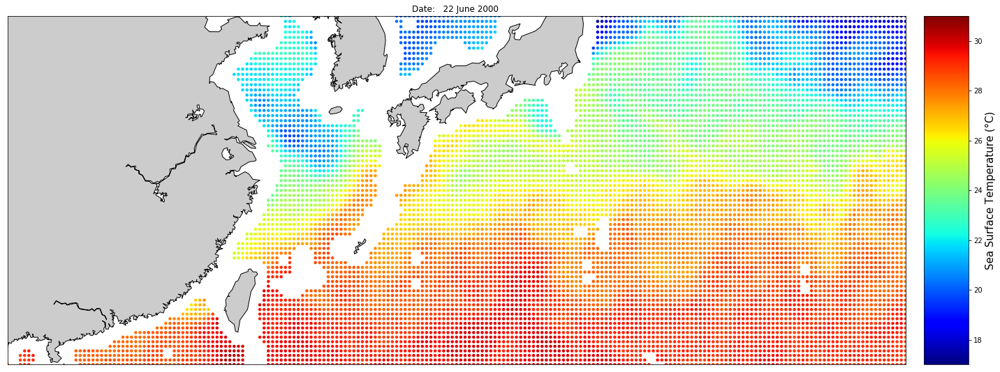

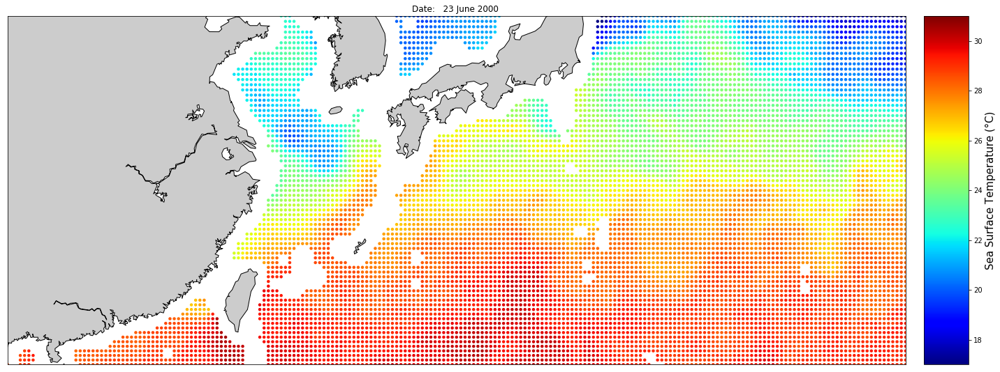

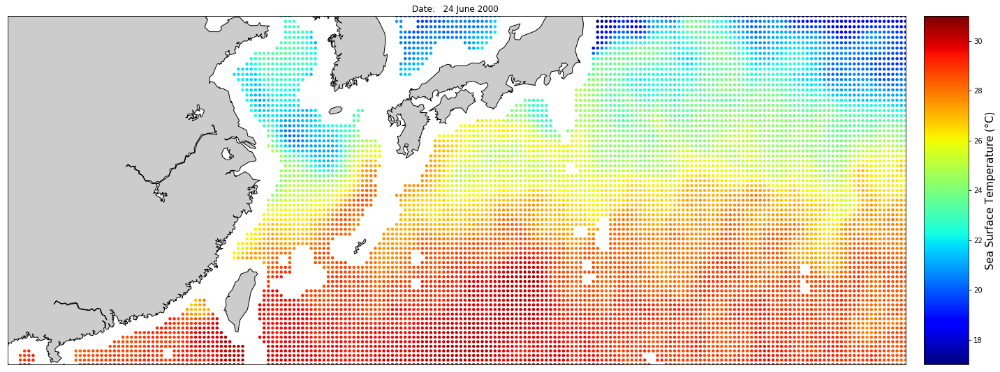

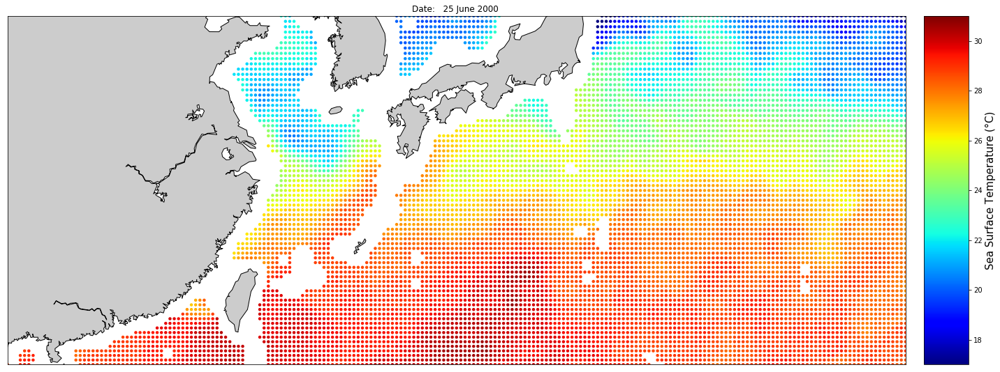

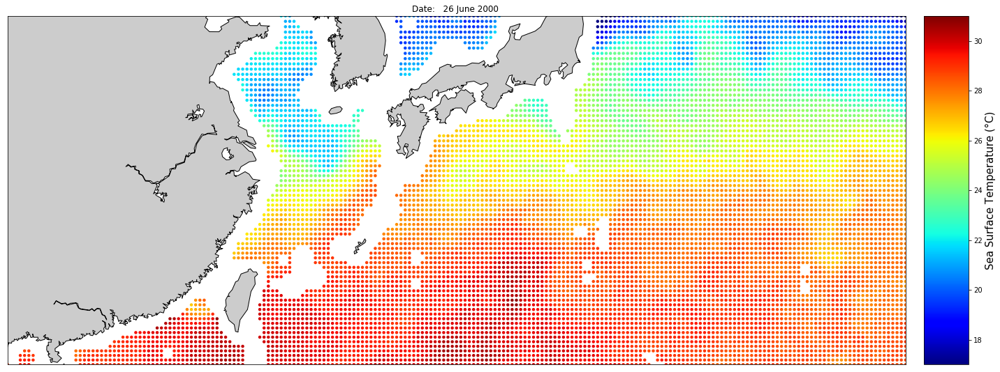

...

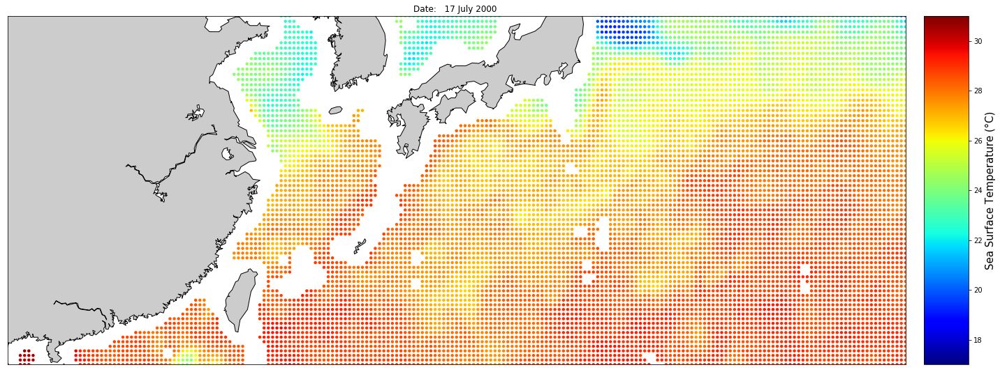

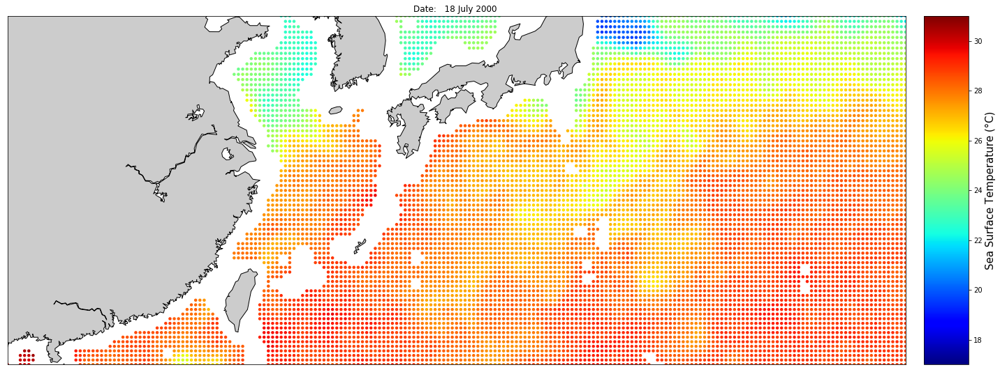

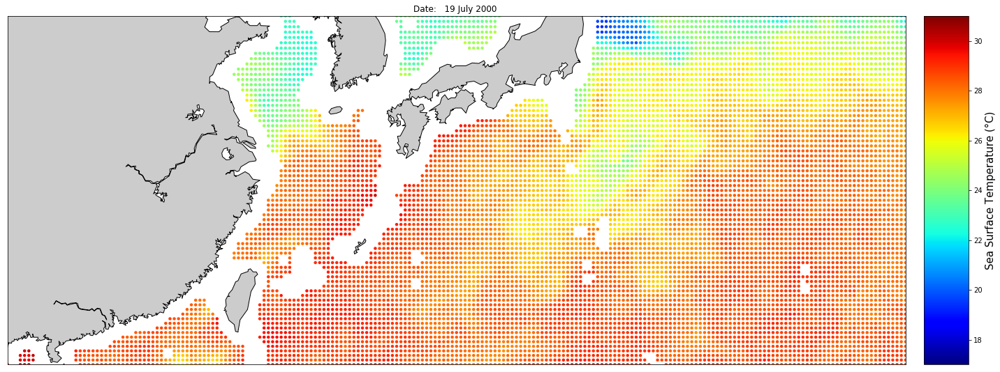

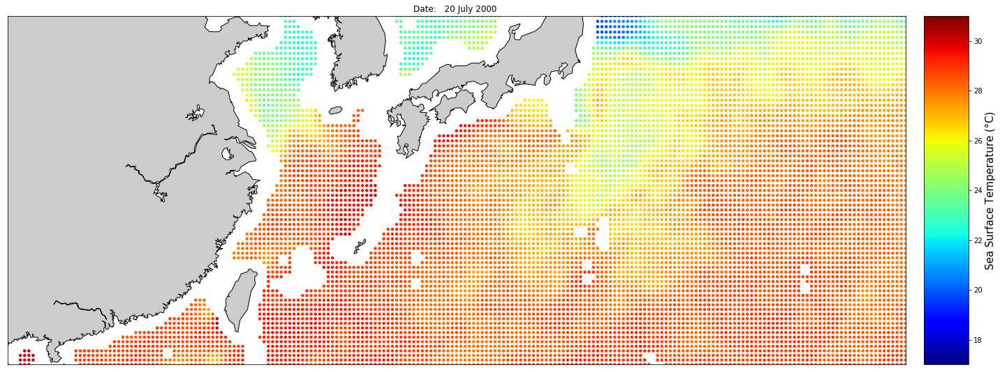

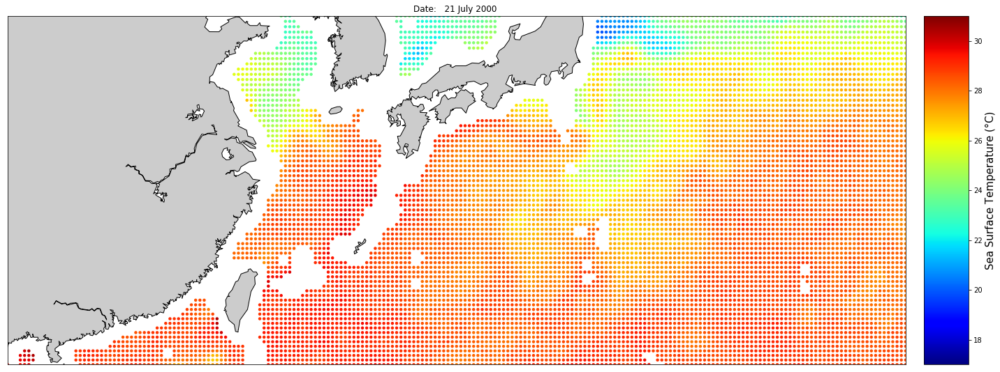

In [0]:
indice = 730304 #2 July 2000
for i in range(30):
  figure()
  plot_im(lon_im,lat_im,sst_plot[indice-10+i],20,'Sea Surface Temperature (°C)')
  tight_layout()
  plt.tight_layout()
  clim([17,31])
  if -9 + i < 0:
    plt.title('Date: %4.d June 2000 ' % int(22+i))
  else:
    plt.title('Date: %4.d July 2000 ' % int(-8+i))
  if i <9:
    savefig('/content/drive/My Drive/Colab Notebooks/typhoon_0' + str(i+1) +'.png',quality = 95,format ='png')
  else:
    savefig('/content/drive/My Drive/Colab Notebooks/typhoon_' + str(i+1) +'.png',quality = 95, format = 'png')



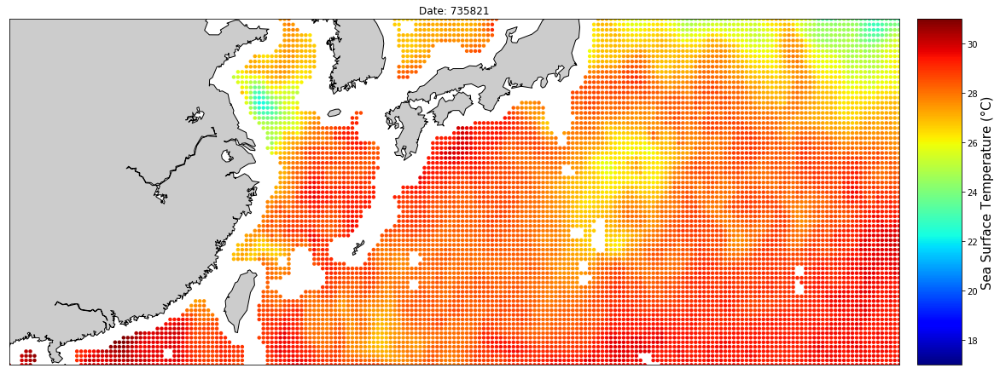

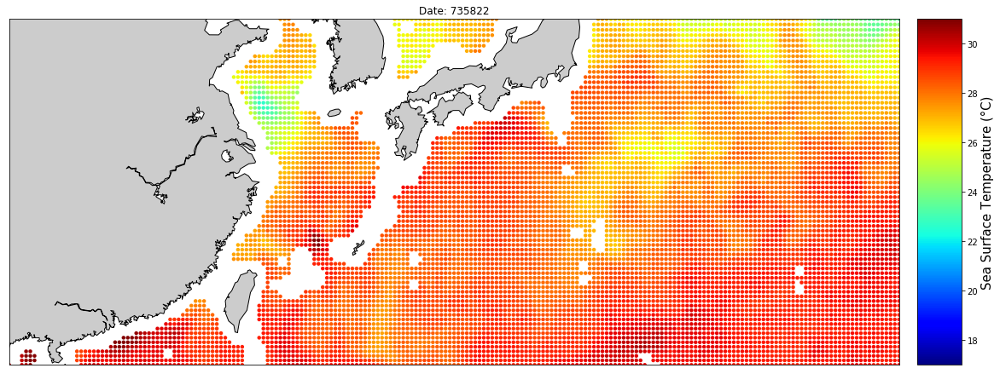

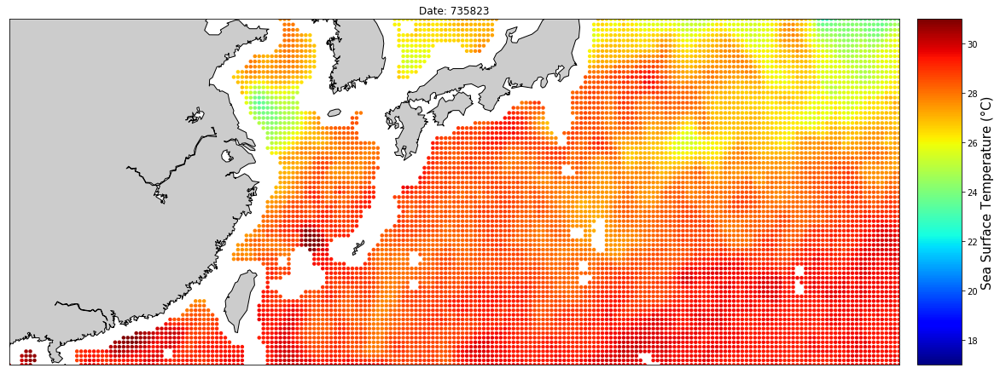

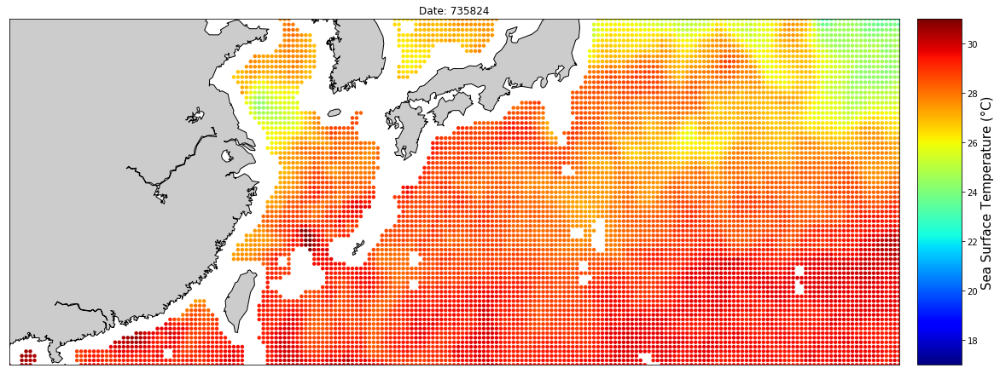

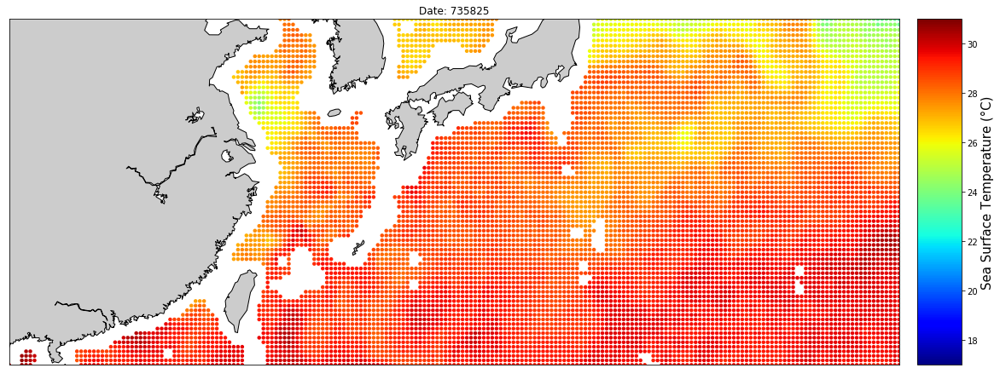

...

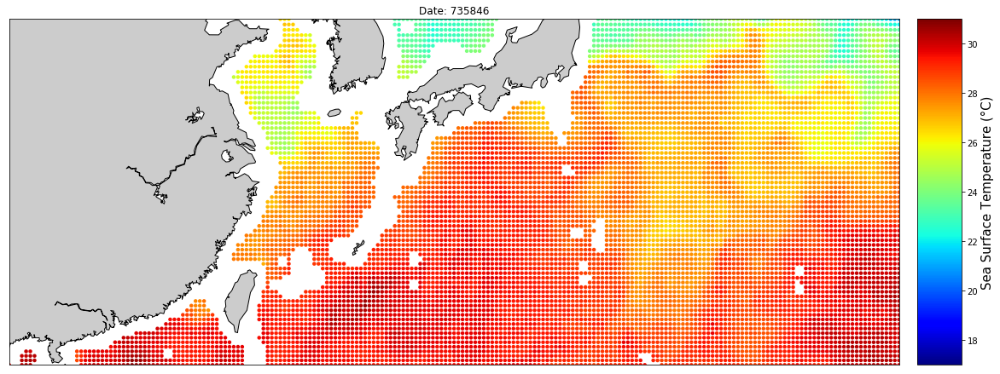

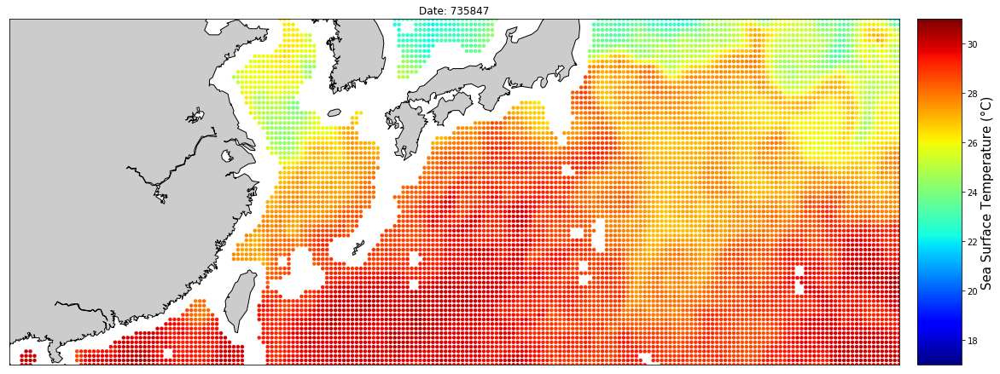

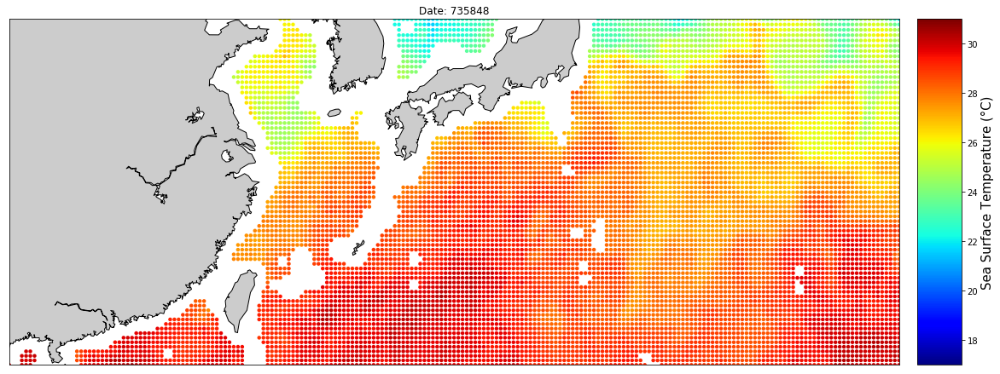

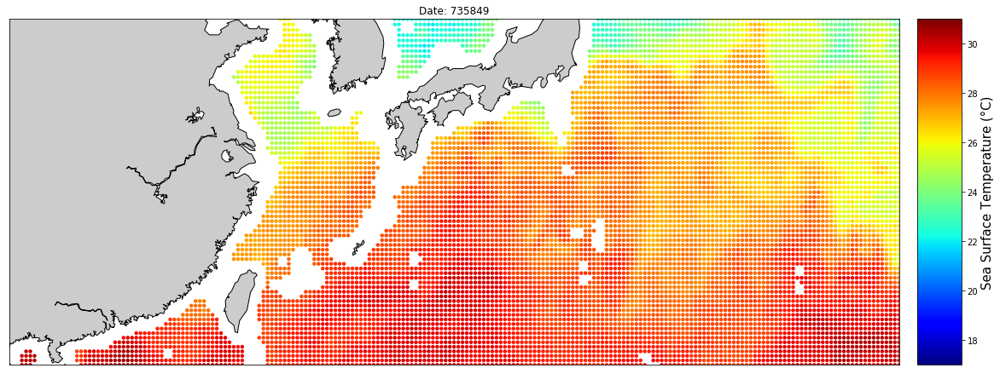

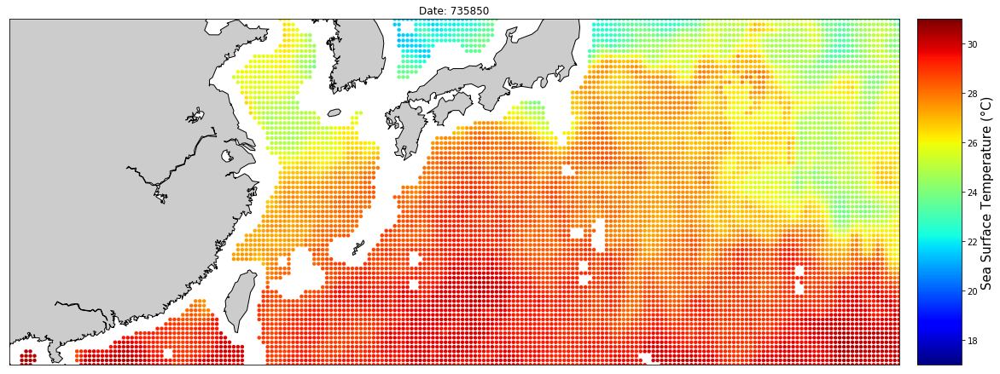

In [0]:
indice = 735821 # 11 Aout 2015
for i in range(30):
  figure()
  plot_im(lon_im,lat_im,sst_plot[indice+i],20,'Sea Surface Temperature (°C)')
  clim([17,31])
  plt.title('Date: %4.d' % int(indice+i))
  if i <9:
    savefig('/content/drive/My Drive/Colab Notebooks/typhoon_sea_0' + str(i+1) +'.png',quality = 95,format ='png',dpi = 200)
  else:
    savefig('/content/drive/My Drive/Colab Notebooks/typhoon_sea_' + str(i+1) +'.png',quality = 95, format = 'png',dpi = 200)
